<a href="https://colab.research.google.com/github/EshaSawant/Face-Image-Generation/blob/main/Face_Generation_What's_under_the_Mask.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Face Generation: What's under the mask

By Esha Sawant, Anisha Jadhav and Joshua Gonzales

In this project, our ideal goal is to take images of someone wearing a mask and replace the mask with an accurate representation of their actual face. We hope to have a high resolution output image that would be believable to the untrained eye. We would also like to use a variety of data to train our model. Faces are very unique and we would like to have a very general output.

We have a few constraints working against us. Those being time, data, and compute power. Due to these constraints, we also have a more modest goal. We should be able to generate unmasked images that, at the very least, look like a face. We also acknowledge that our only dataset, at this point, consists of celebrities and may not provide a generalized output. We may also have to reduce the resolution of our output images in order to speed up training.

Data set: [Celeb A Masked Dataset](https://drive.google.com/drive/u/0/folders/0AEwbUGNR0CrkUk9PVA)

We will be working with the CelebA dataset available to the public on Kaggle. Here is the URL to the dataset:https://www.kaggle.com/datasets/jessicali9530/celeba-dataset (accessed 11/28/2022). This source consists of 202,599, cropped and aligned, celebrity face images. This dataset also provides facial landmark data. This is important because we plan to create our own masked image dataset from CelebA. We will use an existing tool, ‘mask2face’ created by STRV to create this new masked face dataset. The tool is available to use by the public here: https://github.com/strvcom/strv-ml-mask2face. The tool will make use of the facial landmark data to position the synthetic mask onto the image taken from CelebA.

Initially we ran the tool on the images and were able to generate about 7000 train and test images, though we only ended up using the train images since it takes up a lot of space

Deep learning techniques/architectures:

Initially we tried to use image embeddings and pass the embedded images to a demasking model to generate images but the demasking model performs segmentation instead. Since the approach used for both is the same.

At a high level we plan to use a GAN model to try and generate the face behind the mask. This will consist of two networks working together to produce a realistic image. There will be a Generator and a Discriminator network. They will be combined to form our GAN model. The generator will make use of various convolutional methods to produce an image derived from noise. The Discriminator will be acting as a sort of automated supervised learning. It will decide whether or not the Generator’s output is realistic enough to be accepted. We plan to use a convolutional image binary-classifier to achieve this functionality. The binary decision being whether or not the Generator’s output is real or not. We feel fairly experienced in the realm of image classification and are interested in using some of the methods we have used throughout this course. For example, implementing a discriminator using a Siamese network seems interesting.

Importing required libraries

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path
from matplotlib import rcParams
from sklearn.model_selection import train_test_split

from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array

from tensorflow.keras import regularizers
import tensorflow.keras.backend as K

from keras.layers import Dense, LSTM, Dropout, GRU, Bidirectional
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras import models, layers

import imageio
import os
import pathlib
import time
import datetime
from IPython import display
import cv2


Setting default plot size

In [ ]:
# graphics (Note: The correct size will be based accordingly on your respective system)
rcParams['figure.figsize'] = (10,6)

Controlling image aesthetics

In [ ]:
#Using seaborn for setting the figure by controlling its style and scaling the plot.
sns.set_context('notebook', font_scale = 1)   # 'talk' for slightly larger.
sns.set_style('whitegrid')


In [ ]:
#Set the random seed to sample with repetitions
np.random.seed(0)

Plot function for plotting the metrics of a model

In [ ]:
def plot_metric(history, metric='loss'):
    """ Plot training and test values for a metric. """

    val_metric = 'val_'+ metric
    plt.plot(history.history[metric])
    plt.plot(history.history[val_metric])
    plt.title('model '+ metric)
    plt.ylabel(metric)
    plt.xlabel('epoch')
    plt.legend(['train', 'test'])
    plt.show();

#### Mount Drive and read data

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


#### Data Preparation

We are using ImageDataGenerator for generating the images, and setting its parameters. We are using the same dimensions as the originial image, with the batch size as 64.

We will be having separated images directories generated for training and validation.

We are setting 'RGB' color mode as our images are not in grayscale, but they are based on RGB colorful scheme.

In [ ]:
seed=24
batch_size= 64
img_data_gen_args = dict(rescale = 1/255., validation_split=0.2)


image_data_generator = tf.keras.preprocessing.image.ImageDataGenerator(**img_data_gen_args)

In [ ]:
train_generator = image_data_generator.flow_from_directory('/content/drive/Shareddrives/CelebA masked dataset/train/Outputs',
                                                           seed=seed, target_size=(256, 256),
                                                           batch_size=batch_size,
                                                           class_mode='input', #this is used for autoencoders
                                                           color_mode='rgb',
                                                           subset= 'training')# set as training data

val_generator = image_data_generator.flow_from_directory('/content/drive/Shareddrives/CelebA masked dataset/train/Outputs',
                                                           seed=seed, target_size=(256, 256),
                                                           batch_size=batch_size,
                                                           class_mode='input', #this is used for autoencoders++++++++++
                                                           color_mode='rgb',
                                                           subset= 'validation')# set as validation data

train_generator_mask = image_data_generator.flow_from_directory('/content/drive/Shareddrives/CelebA masked dataset/train/Inputs',
                                                           seed=seed, target_size=(256, 256),
                                                           batch_size=batch_size,
                                                           class_mode='input', #this is used for autoencoders++++++++++
                                                           color_mode='rgb',
                                                           subset= 'training')# set as training data

val_generator_mask = image_data_generator.flow_from_directory('/content/drive/Shareddrives/CelebA masked dataset/train/Inputs',
                                                           seed=seed, target_size=(256, 256),
                                                           batch_size=batch_size,
                                                           class_mode='input', #this is used for autoencoders++++++++++
                                                           color_mode='rgb',
                                                           subset= 'validation')# set as validation data

Found 6015 images belonging to 1 classes.
Found 1503 images belonging to 1 classes.
Found 6015 images belonging to 1 classes.
Found 1503 images belonging to 1 classes.


## AutoEncoder - DeMask Model

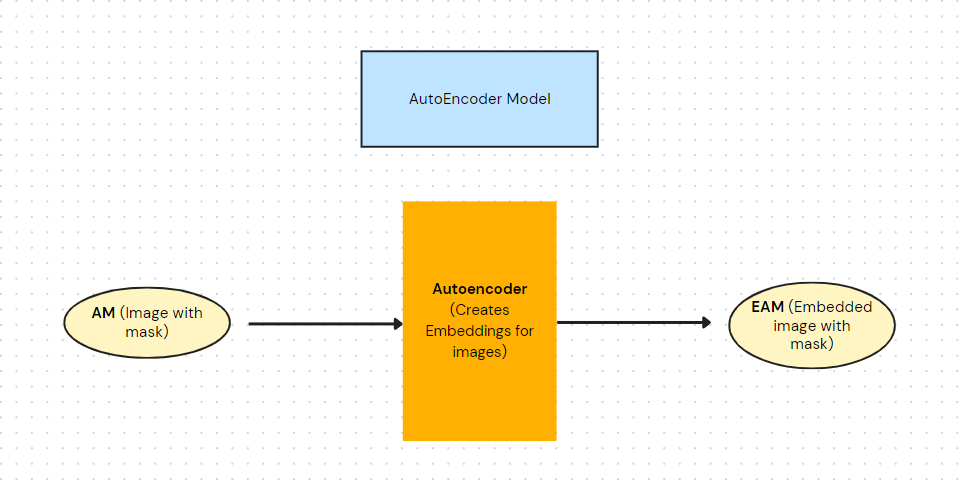

The Autoencoder model has the same architecture as a transformer used in NLP models but here is creates embeddings for images. It takes in a masked image and creates embeddings for the same.
An autoencoder is generally used to reduce the noise in the data and therefore is an unsupervised machine learning technique.

In [ ]:
#Clear old sessions
K.clear_session()

The Autoencoder we are using to create image embeddings

In [ ]:
input_img = keras.Input(shape= (256,256,3))

#encoder
x = layers.Conv2D(128, (3,3), activation = 'relu', padding= 'same')(input_img)
x = layers.MaxPooling2D((2,2), padding= 'same')(x)
x = layers.Conv2D(64, (3,3), activation = 'relu', padding= 'same')(x)
x = layers.MaxPooling2D((2,2), padding= 'same')(x)
x = layers.Conv2D(32, (3,3), activation = 'relu', padding= 'same')(x)
encoding = layers.MaxPooling2D((2,2), padding= 'same')(x)

#decoder
x = layers.Conv2DTranspose(32, 3, activation= 'relu', padding= 'same')(encoding)
x = layers.Conv2DTranspose(24, 3, activation= 'relu', padding= 'same', strides= 2)(x)
x = layers.Conv2DTranspose(12, 3, activation= 'relu', padding= 'same', strides= 2)(x)
x = layers.Conv2DTranspose(6, 3, activation= 'relu', padding= 'same', strides= 2)(x)
decoding = layers.Conv2D(3, (3,3), activation= 'sigmoid', padding= 'same')(x)


In [ ]:
autoEncoder = keras.Model(input_img, decoding)
autoEncoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 256, 256, 128)     3584      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 128, 128, 128)    0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 64)      73792     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 64, 64, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 32)        18464 

Our model has about 115,500 trainable parameters and we are using MSE loss as it gave us much better results than Binary Cross Entropy

In [ ]:
autoEncoder.compile(optimizer= 'adam', loss= 'MSE', metrics=['accuracy'])

In [ ]:
history = autoEncoder.fit(train_generator, validation_data = val_generator, epochs= 5)

Epoch 1/5
94/94 [==============================] - 170s 522ms/step - loss: 0.0538 - accuracy: 0.7196 - val_loss: 0.0324 - val_accuracy: 0.8313
Epoch 2/5
94/94 [==============================] - 46s 488ms/step - loss: 0.0297 - accuracy: 0.8295 - val_loss: 0.0275 - val_accuracy: 0.8367
Epoch 3/5
94/94 [==============================] - 46s 492ms/step - loss: 0.0259 - accuracy: 0.8296 - val_loss: 0.0248 - val_accuracy: 0.8313
Epoch 4/5
94/94 [==============================] - 46s 490ms/step - loss: 0.0220 - accuracy: 0.8119 - val_loss: 0.0187 - val_accuracy: 0.8308
Epoch 5/5
94/94 [==============================] - 46s 490ms/step - loss: 0.0142 - accuracy: 0.8403 - val_loss: 0.0044 - val_accuracy: 0.8570


We are only training our AutoEncoder model for 5 epochs as training more would not be of any use for our DeMask model. We still need the image to be recogizable.

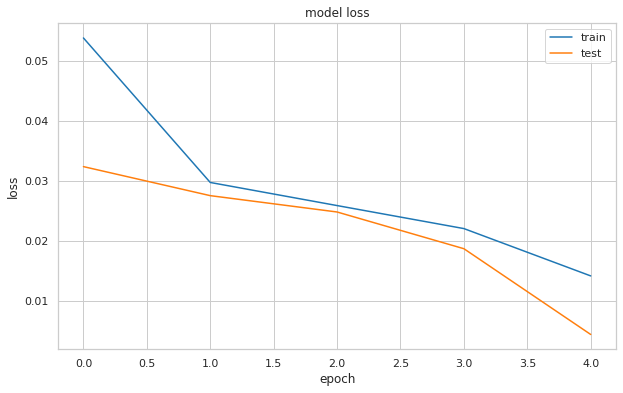

In [ ]:
plot_metric(history)

<class 'PIL.Image.Image'>


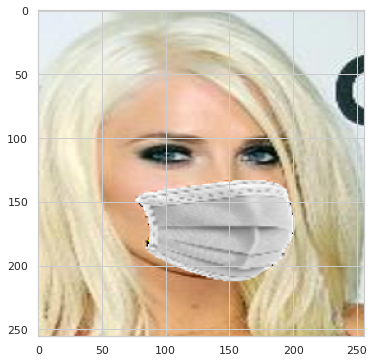

In [ ]:
#only picking one image to test the model. Will need to create some sort of test data to pic from
img = load_img("/content/drive/Shareddrives/CelebA masked dataset/train/Inputs/inputs/000001.png")
print(type(img))
plt.imshow(img)

1/1 [==============================] - 0s 299ms/step


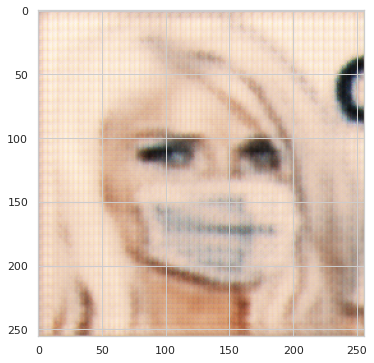

In [ ]:
# convert to numpy array
X = np.zeros((1, 256, 256, 3))
X[0] = np.array(img)
X[0] = X[0] * (1/255.)
decoded_imgs = autoEncoder.predict(X)
# Image is blurry, we can try increasing the embedding dimensions
plt.imshow(decoded_imgs[0])

Fitting the AutoEncoder model on image generators with masked and unmasked training images.

In [ ]:
train_AE = autoEncoder.predict(train_generator)
train_AE_mask = autoEncoder.predict(train_generator_mask)

94/94 [==============================] - 4249s 46s/step


In [ ]:
print(train_AE.shape)
print(train_AE_mask.shape)

(6015, 256, 256, 3)
(6015, 256, 256, 3)


Using .predict on a image generator converts it to a numpy array and it takes up a lot of memory space therefore we decided to create training and test data from the above perdicted numpy arrays.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(train_AE_mask, train_AE, test_size = 0.3)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(4210, 256, 256, 3)
(4210, 256, 256, 3)
(1805, 256, 256, 3)
(1805, 256, 256, 3)


#### DeMask model

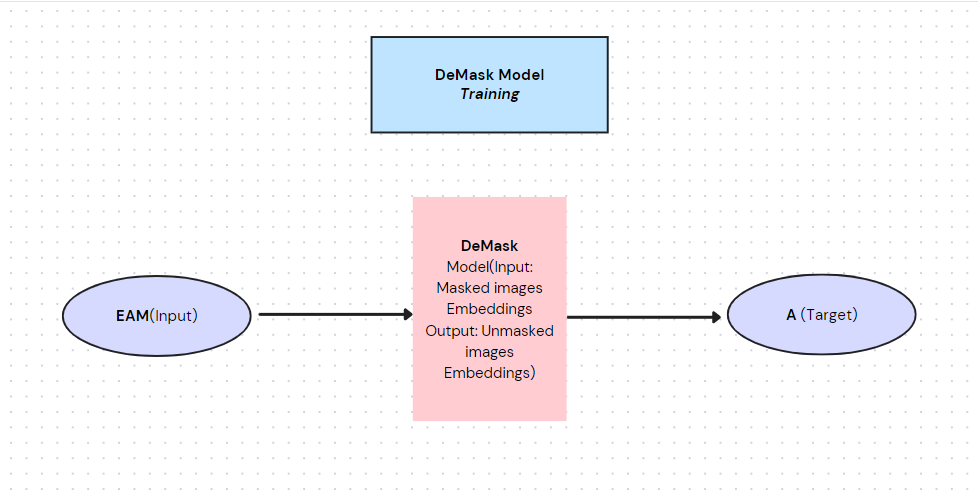

The DeMask model would have been our supervised training model. The goal was to give the DeMask model image embeddings for masked images and have the image embeddings for original images as the target values.

The DeMask model consists of Convulation, Convulation Transpose, and Dense layers. We are also using Maxpooling and Dropout layers. Since the images have 3 output channels for RGB color scheme, our output layer is filter size 3.

In [ ]:
K.clear_session()

In [ ]:
input_img = keras.Input(shape=(256,256,3))

x = layers.Conv2D(100, 3, activation='relu',padding='same')(input_img)
x = layers.MaxPooling2D(2,2)(x)
x = layers.Conv2D(100, 3, activation='relu',padding='same')(x)
x = layers.MaxPooling2D(2,2)(x)
x = layers.Conv2DTranspose(100, 3, strides=2, activation='relu',padding='same')(x)
x = layers.Conv2DTranspose(100, 3, strides = 2, activation='relu',padding='same')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(50,activation='relu')(x)
output = layers.Dense(3, activation='sigmoid')(x)

DeMask = keras.Model(input_img,output)

In [ ]:
DeMask.summary()

In [ ]:
#Compile the DeMask Model
DeMask.compile(optimizer= 'adam', loss= 'binary_crossentropy', metrics=['accuracy'])

We are using Early stopping with our DeMask model since we are training for about 100 epochs. Training our DeMask model for more epochs would theoretically give us better results.

In [ ]:
early_stopping = keras.callbacks.EarlyStopping(patience=3, monitor = 'val_loss')
history = DeMask.fit(X_train, y_train, epochs = 100, batch_size= 16, validation_data = (X_test,y_test), callbacks=[early_stopping])

While I was training the DeMask model, there was no significant decrease in the validation loss and it seemed to remain in the same range with each training epoch.

In [ ]:
plot_metric(history)

In [ ]:
img = load_img("/content/drive/Shareddrives/CelebA masked dataset/train/Inputs/inputs/002001.png")
# convert to numpy array
X = np.zeros((1, 256, 256, 3))
X[0] = np.array(img)
X[0] = X[0] * (1/255.)
decoded_imgs = autoEncoder.predict(X)
plt.imshow(decoded_imgs[0]);

In [ ]:
unmasked_img = DeMask.predict(decoded_imgs)
plt.imshow(unmasked_img[0])

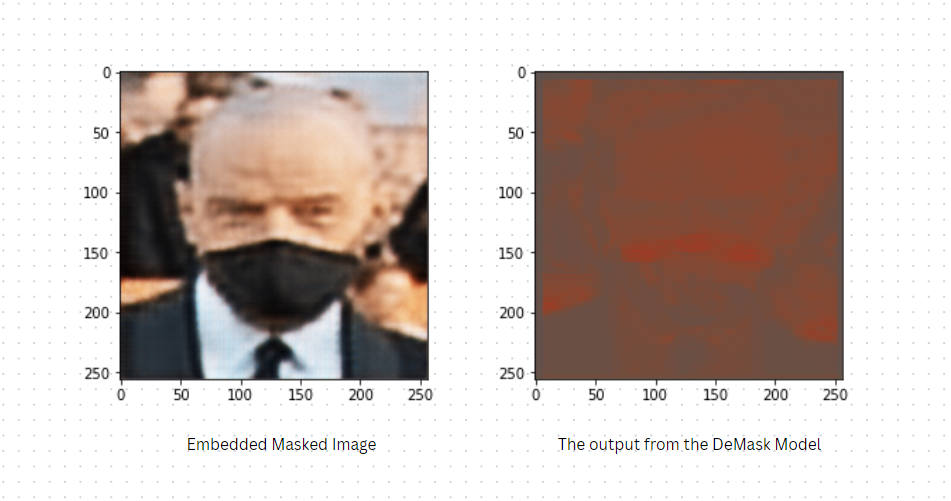

The output from the our trained DeMask model was nowhere near our target image. Unmasked images also gave a similar output and therefore we stopped working with the autoencoder model.

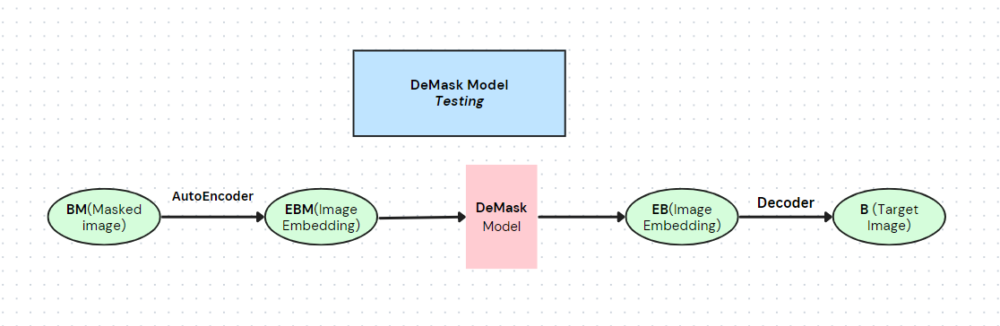

The image above explains our theory with the Autoencoder and DeMasking model and how we wanted it to perform. Theoretically it was easier than the GAN model and had many controllable parameters but we couldn't find any explainable cause for the model to not work. There might be some problems with our autoencoder model and could be one of the reasons for failure.

#### Data preparation for GAN Model

Loading the training dataset with size 128 x 128 and scale with 255.0 (to normalize the images). Then, we will be converting them into array and resize data.

In [ ]:
DATA=[]
for i,j in zip(sorted(os.listdir('/content/drive/Shareddrives/CelebA masked dataset/train/Inputs/inputs'))[:1000],
                                    sorted(os.listdir('/content/drive/Shareddrives/CelebA masked dataset/train/Outputs/outputs'))[:1000]):
  INP=cv2.imread(f'/content/drive/Shareddrives/CelebA masked dataset/train/Inputs/inputs{i}')
  INP=cv2.resize(INP,(128,128))/255.0
  OUT=cv2.imread(f'/content/drive/Shareddrives/CelebA masked dataset/train/Outputs/outputs{j}')
  OUT=cv2.resize(OUT,(128,128))/255.0
  DATA.append((INP,OUT))
DATA=np.array(DATA)
Input_x_train=np.array([i for i in DATA[:,0]]).reshape((1000,128,128,3))
Output_y_train=np.array([i for i in DATA[:,1]]).reshape((1000,128,128,3))

In [ ]:
DATA_=[]
for i,j in zip(sorted(os.listdir('/content/drive/Shareddrives/CelebA masked dataset/train/Inputs/inputs'))[:500],
                                    sorted(os.listdir('/content/drive/Shareddrives/CelebA masked dataset/train/Outputs/outputs'))[:500]):
  INP_=cv2.imread(f'/content/drive/Shareddrives/CelebA masked dataset/train/Inputs/inputs{i}')
  INP_=cv2.resize(INP_,(128,128))/255.0
  OUT_=cv2.imread(f'/content/drive/Shareddrives/CelebA masked dataset/train/Outputs/outputs{j}')
  OUT_=cv2.resize(OUT_,(128,128))/255.0
  DATA_.append((INP_,OUT_))
DATA_=np.array(DATA_)
Input_x_test=np.array([i for i in DATA_[:,0]]).reshape((500,128,128,3))
Output_y_test=np.array([i for i in DATA_[:,1]]).reshape((500,128,128,3))

Now, that we have our both datasets ready, we can plot some samples from the dataset and see the results.

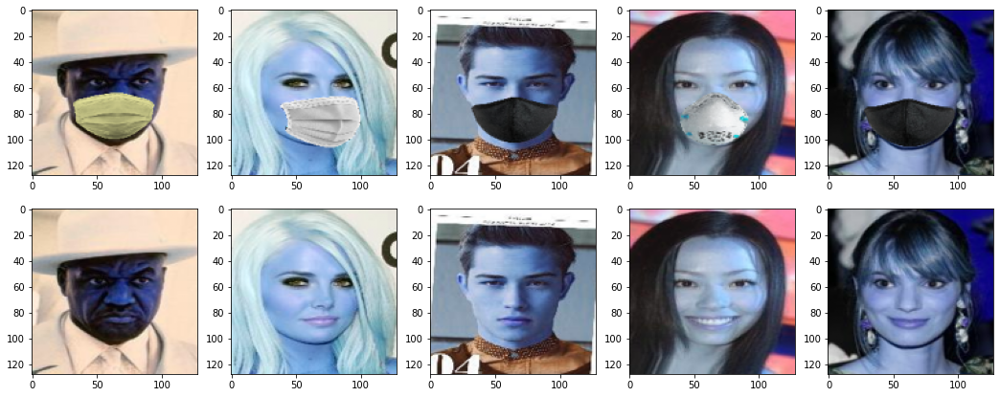

In [ ]:
#Samples from the training dataset
plt.rcParams['figure.figsize']=(18,7)
plt.subplot(2,5,1)
plt.imshow(Input_x_train[0])
plt.subplot(2,5,2)
plt.imshow(Input_x_train[1])
plt.subplot(2,5,3)
plt.imshow(Input_x_train[2])
plt.subplot(2,5,4)
plt.imshow(Input_x_train[3])
plt.subplot(2,5,5)
plt.imshow(Input_x_train[4])

plt.subplot(2,5,6)
plt.imshow(Output_y_train[0])
plt.subplot(2,5,7)
plt.imshow(Output_y_train[1])
plt.subplot(2,5,8)
plt.imshow(Output_y_train[2])
plt.subplot(2,5,9)
plt.imshow(Output_y_train[3])
plt.subplot(2,5,10)
plt.imshow(Output_y_train[4])
plt.show()

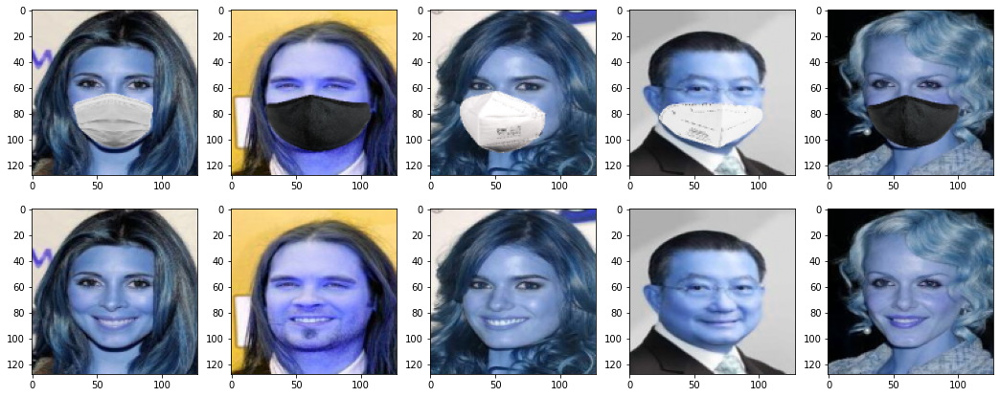

In [ ]:
#Samples from the Test dataset
plt.rcParams['figure.figsize']=(18,7)
plt.subplot(2,5,1)
plt.imshow(Input_x_test[0])
plt.subplot(2,5,2)
plt.imshow(Input_x_test[1])
plt.subplot(2,5,3)
plt.imshow(Input_x_test[2])
plt.subplot(2,5,4)
plt.imshow(Input_x_test[3])
plt.subplot(2,5,5)
plt.imshow(Input_x_test[4])

plt.subplot(2,5,6)
plt.imshow(Output_y_test[0])
plt.subplot(2,5,7)
plt.imshow(Output_y_test[1])
plt.subplot(2,5,8)
plt.imshow(Output_y_test[2])
plt.subplot(2,5,9)
plt.imshow(Output_y_test[3])
plt.subplot(2,5,10)
plt.imshow(Output_y_test[4])
plt.show()

Both the images with mask and unmasked faces seems to be pretty clear and well plotted.

In [ ]:
#Creating batches of size 32
train_data=tf.data.Dataset.from_tensor_slices((tf.cast(Input_x_train,tf.float32),tf.cast(Output_y_train,tf.float32))).batch(32)
test_data=tf.data.Dataset.from_tensor_slices((tf.cast(Input_x_test,tf.float32),tf.cast(Output_y_test,tf.float32))).batch(32)
train_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None))>

# Generative Adverserial Network

Now, we first write the function for downsampling the images for efficient feature extraction. It consists of Convolution layers for feature extraction, Batchnorm layers for Normalization and LeakyRelu Function for applying some non-
linearity to the model. But Batchnorm layers are applied only while the training process.

In [ ]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

Next, we write the function for upsampling the images. In this function, we have Conv2DTranspose layers for upsampling, and again Batchnorm layer for normalization. The Dropout layer is also used for avoiding overfitting and lastly, we have Simple Relu layer (activation function).

In [ ]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [ ]:
#Defining the number of output channels
OUTPUT_CHANNELS=3

This is Generator part in which we create new images using encoding and decoding via Convolutional neural network.

In down sampling block of code, we have 6 layers for down sampling and while in upsampling block of code, we have 4 layers for again reconstructing the images
to fool the Discriminator.

In [ ]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[128, 128, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
                                # downsample(512, 4),  # (batch_size, 2, 2, 512)
                                # downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
                                # upsample(128, 4),  # (batch_size, 64, 64, 256)
                                # upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

Now, that we have our Generator part ready, let's plot and see the generator structure.

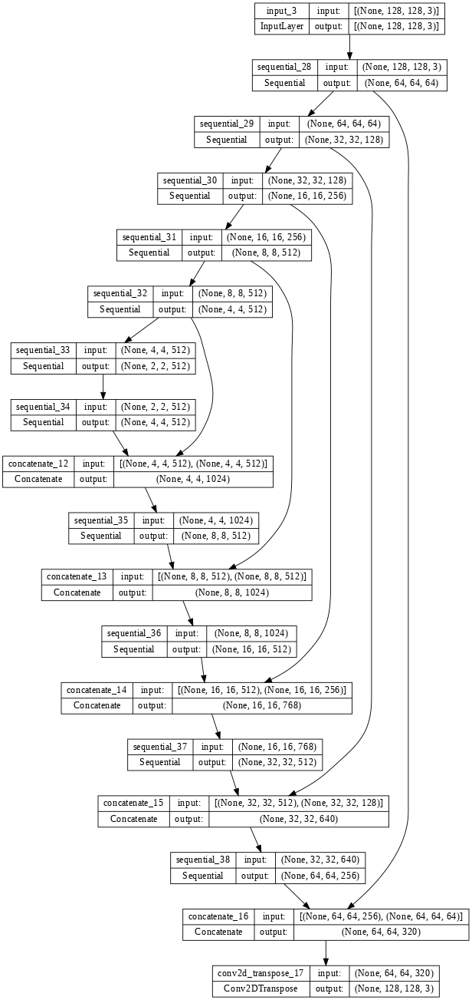

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

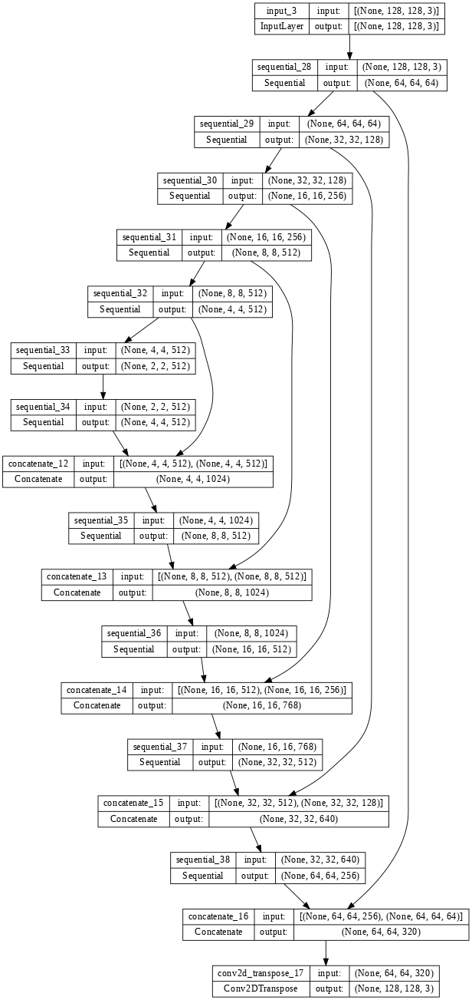

In [ ]:
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64,to_file='Generator.png')

Now, we can also check whether the Generator is gving them simple random noise or not. We will check it by setting the simple random noise vector of (128, 128, 3).

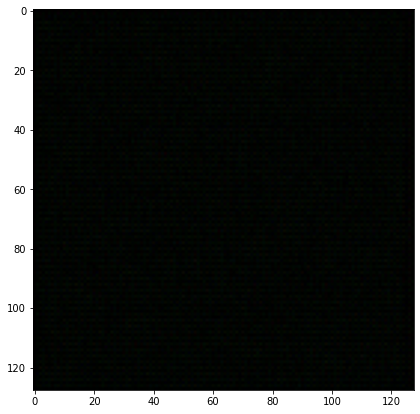

In [ ]:
gen_output = generator(tf.random.uniform((1,128,128,3)), training=False)
plt.imshow(gen_output[0, ...])

Now, in the next part, we will initialize the gen loss and Discriminator.
The discriminator's task is to find or differentiate between fake and real images, so it is simply acting as a classifier which predicts whether the image is real (for dataset), or fake (produced by the generator).

In [ ]:
LAMBDA = 100
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss


def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[128, 128, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[128, 128, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

Let's plot the Discriminator structure.

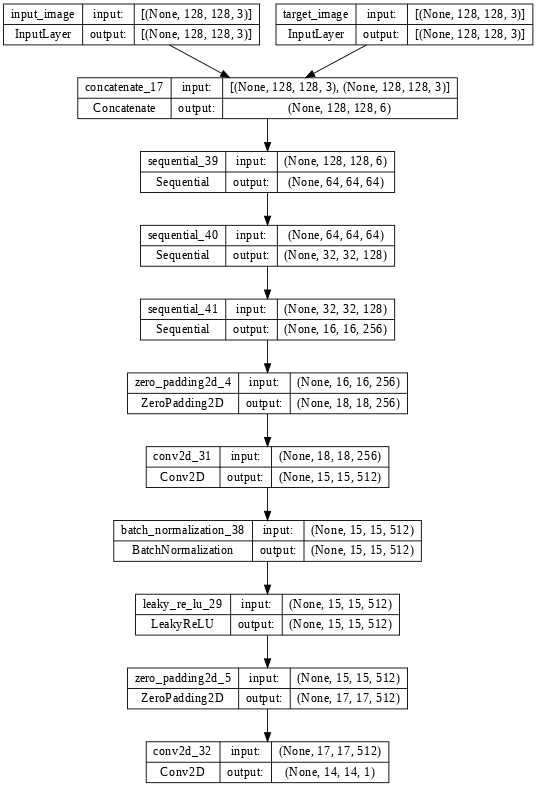

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

Now, we will check the Discriminator by giving them 2 vectors to find out whether the Discriminator found out the actual and fake image or not. As we discussed earlier that the discriminator will differentiate between real and fake image.

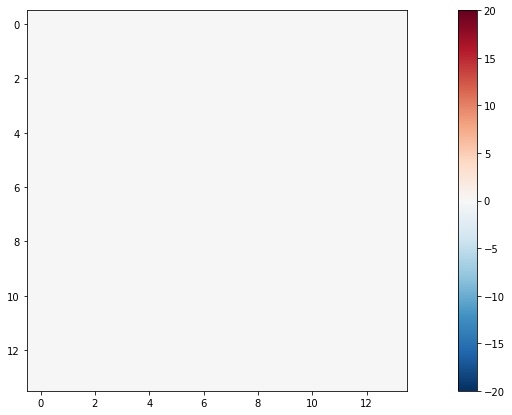

In [ ]:
disc_out = discriminator([tf.random.uniform((1,128,128,3)),tf.random.uniform((1,128,128,3))])
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

We will be using function of discriminator loss but our main task is to minimize this loss.

In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss

Initializing the optimizers for both Generator and the Discriminator.

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

Now, let's check with our samples images example and plot them.

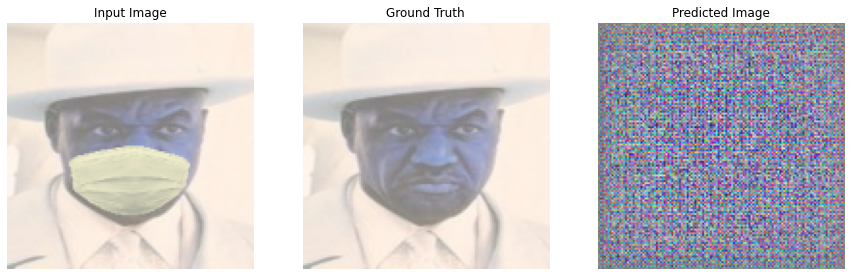

In [ ]:
for example_input, example_target in train_data.take(1):
  generate_images(generator, example_input, example_target)

We see that the model is unable at all to predict the image that good. But overall, we can assume that it is a good starting and explore further for improvising it.

In [ ]:
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

Initializing all parameters for training:

In [ ]:
@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

Now, we will be training the model for face unmasking.

In [ ]:
def fit(train_ds, test_ds, steps):
  example_input, example_target = next(iter(test_ds.take(1)))
  start = time.time()

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")

    train_step(input_image, target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)


    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 15359), started 0:06:13 ago. (Use '!kill 15359' to kill it.)

<IPython.core.display.Javascript object>

Time taken for 1000 steps: 517.08 sec



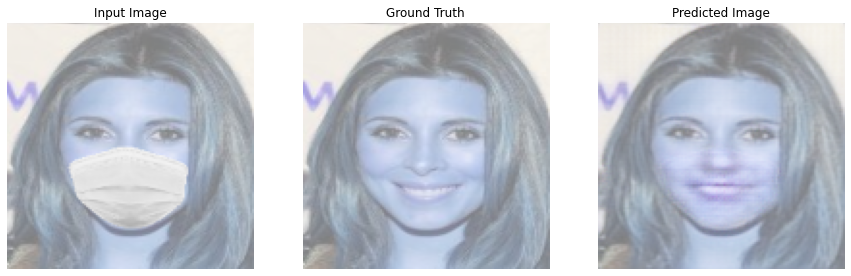

Step: 3k
....................................................................................................

In [ ]:
fit(train_data,test_data, steps=4000)

## Testing

In [ ]:
display.IFrame(
    src="https://tensorboard.dev/experiment/lZ0C6FONROaUMfjYkVyJqw",
    width="100%",
    height="1000px")

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

First, we will test the samples images and try on five images.

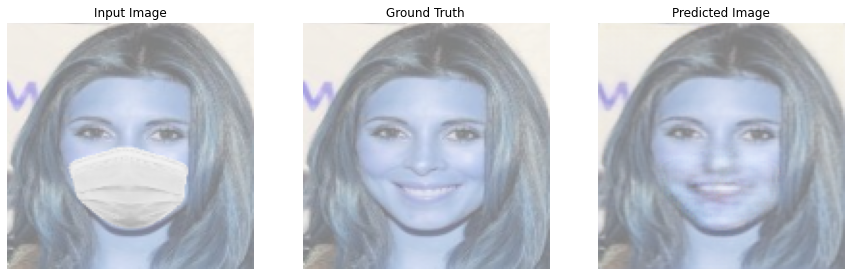

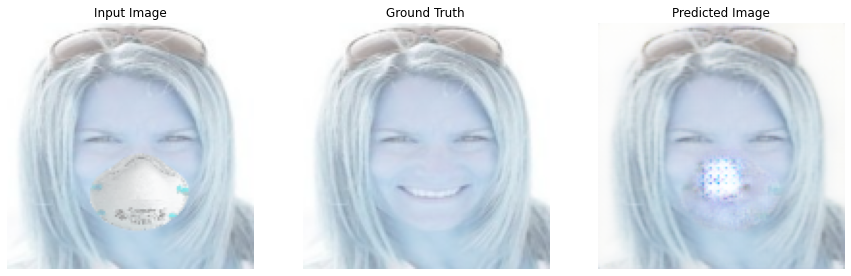

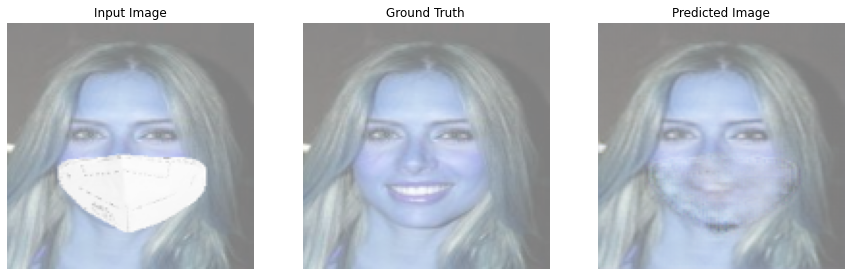

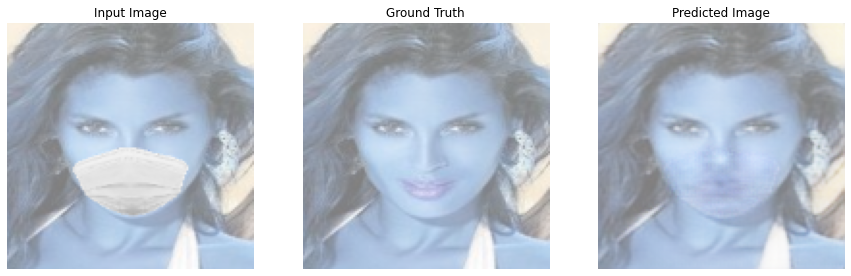

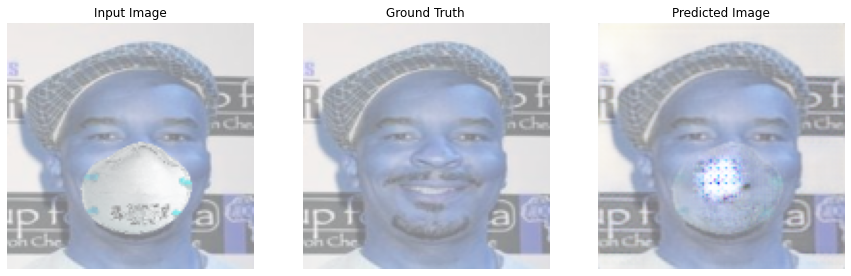

In [ ]:
for inp, tar in test_data.take(5):
  generate_images(generator, inp, tar)

We see, comparatively, better or rather pretty good results of the faces generated without mask. We can easily spot the difference between the first image with face, second image without mask and the generated image without the mask. We were really surprised with the results!

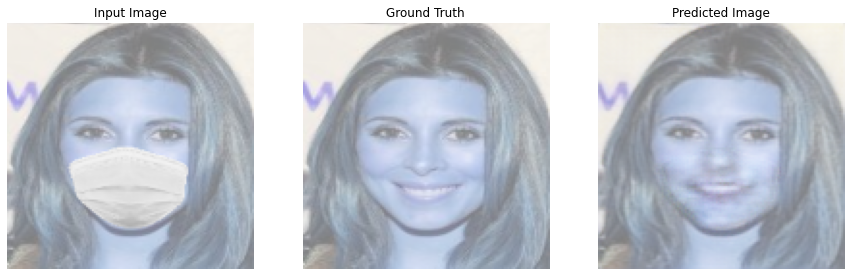

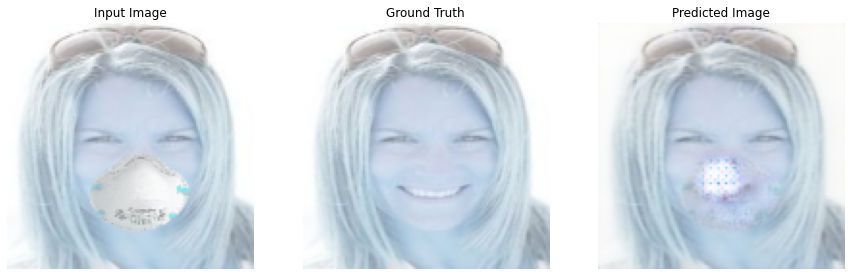

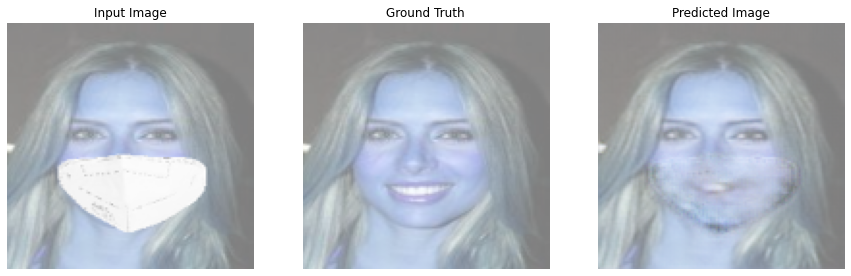

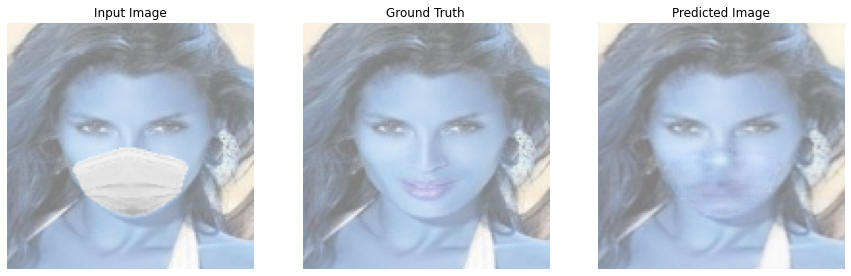

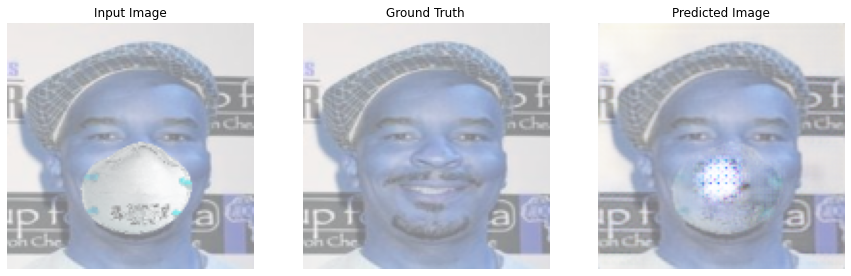

...

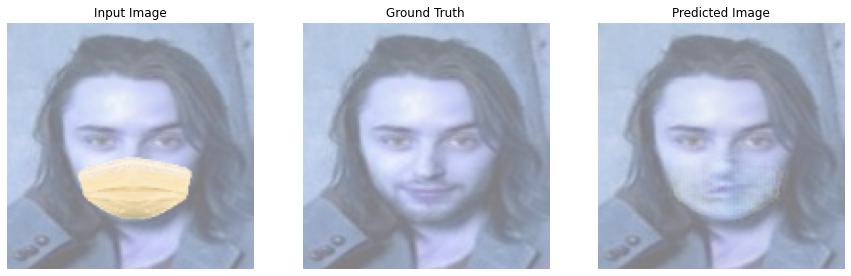

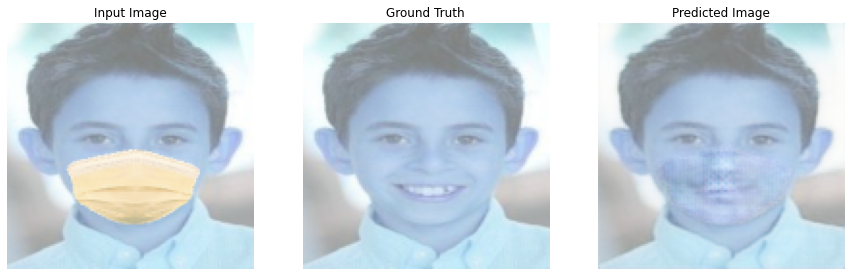

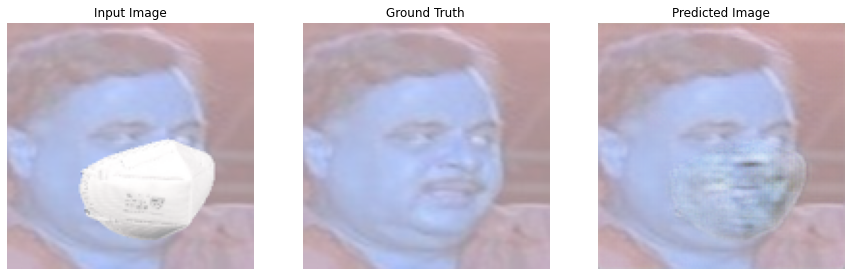

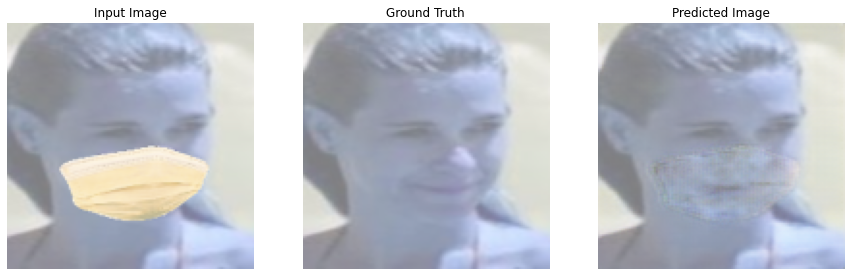

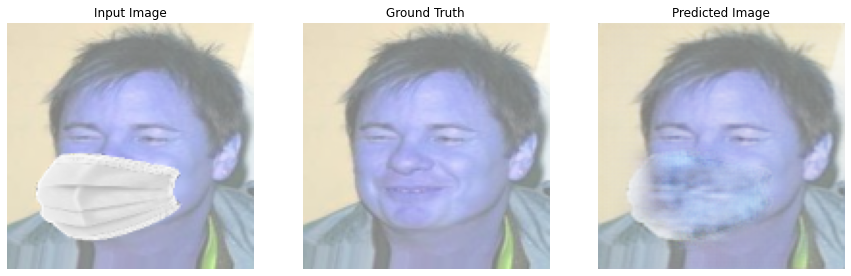

In [ ]:
for inp, tar in test_data.take(30):
  generate_images(generator, inp, tar)

Here also, we can observe that the front or straight images of the celebrities are predicted/generated without masks more accurately than the ones with side views or have slight angles change of the faces.

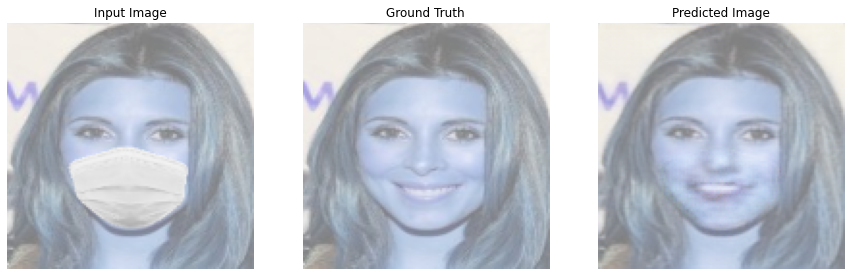

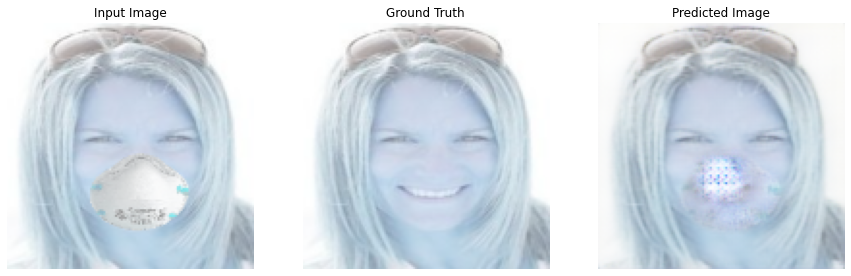

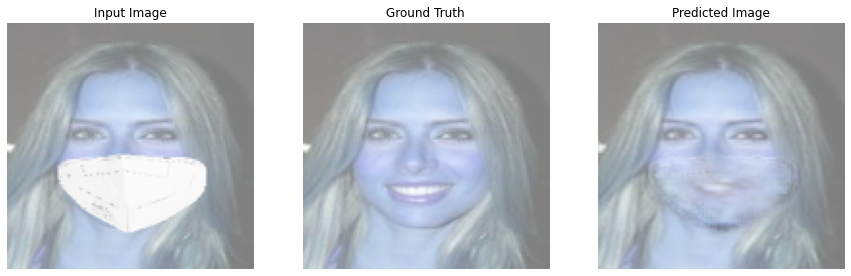

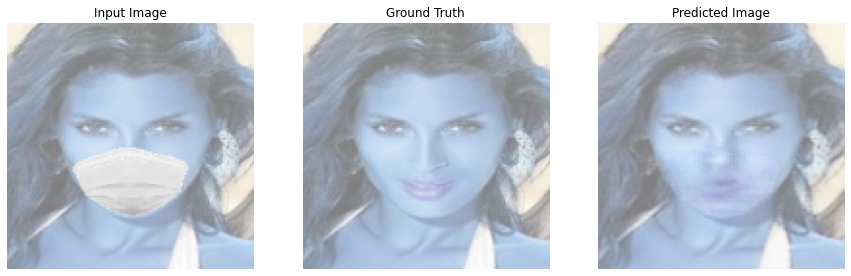

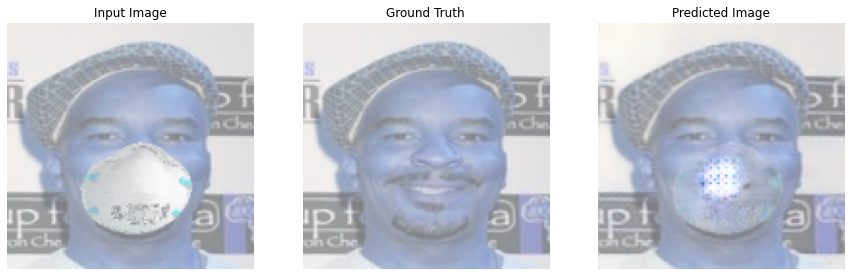

...

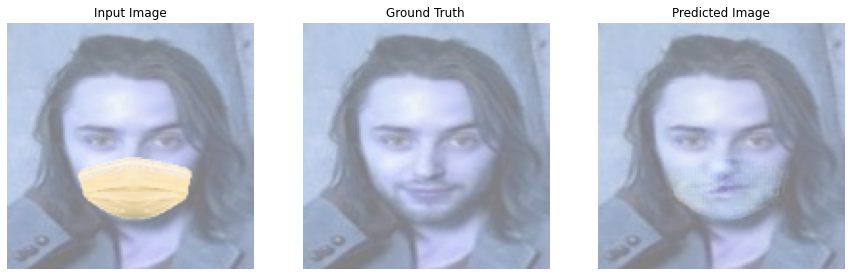

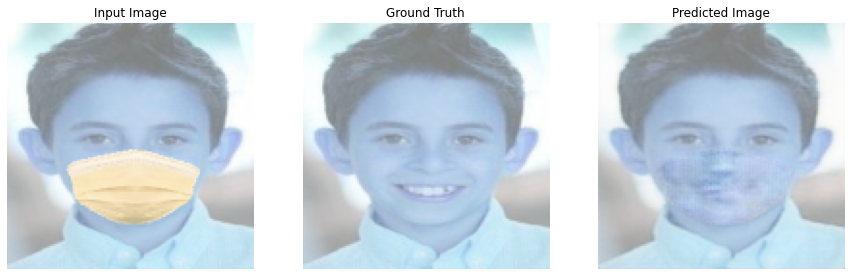

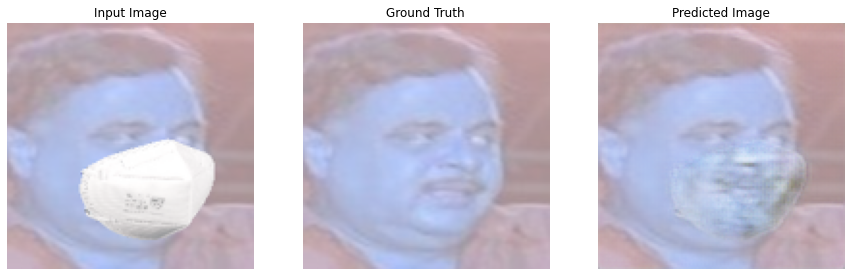

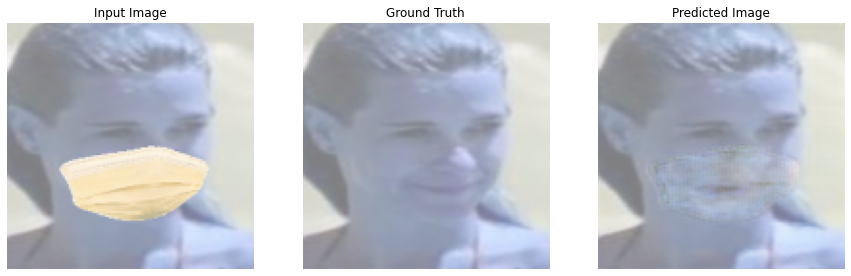

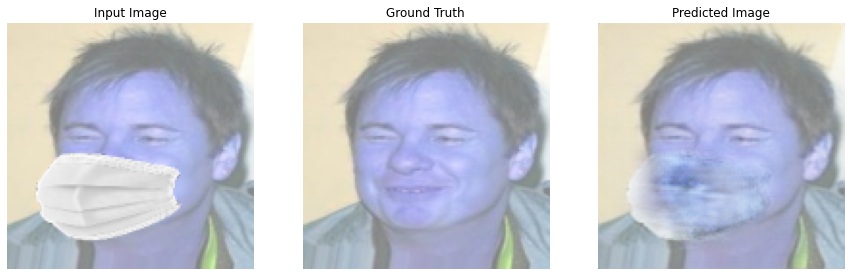

In [ ]:
for inp, tar in test_data.take(50):
  generate_images(generator, inp, tar)

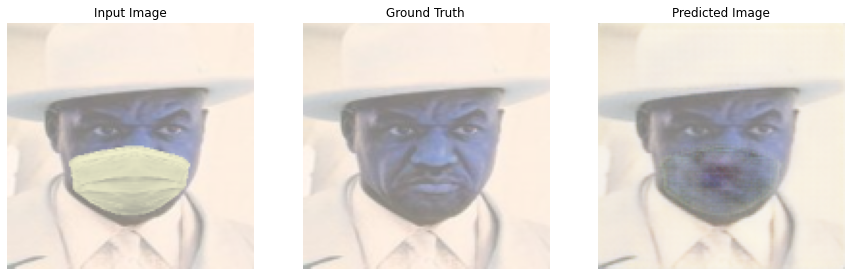

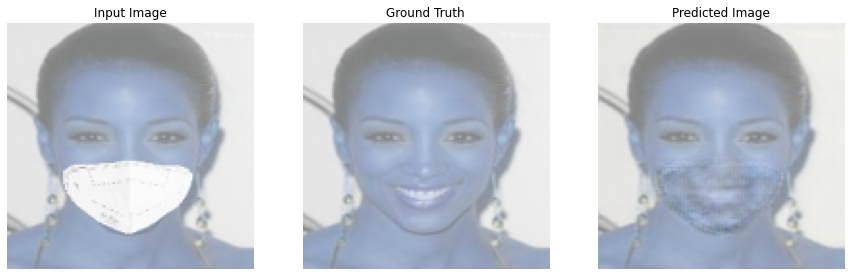

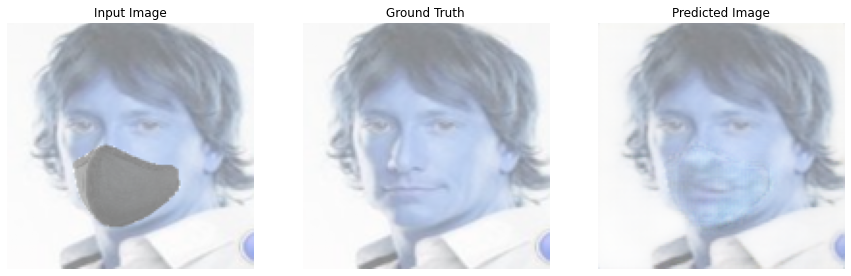

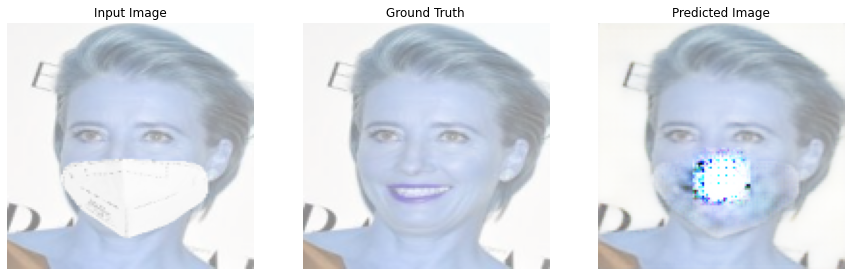

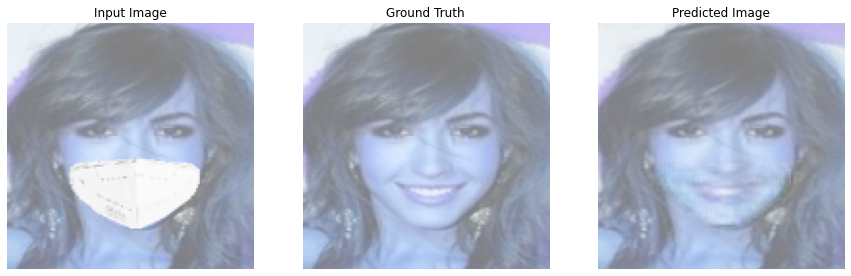

...

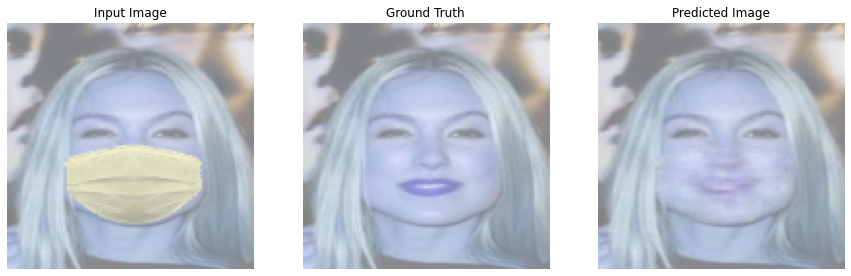

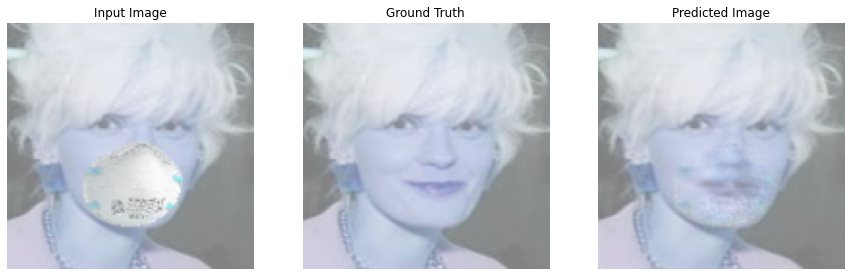

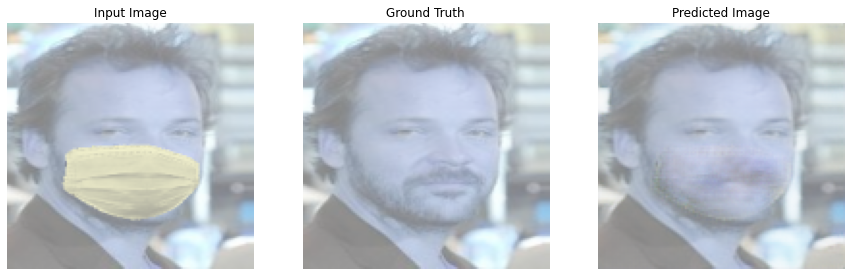

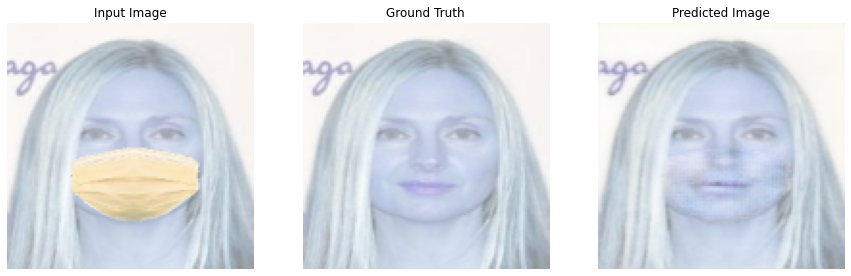

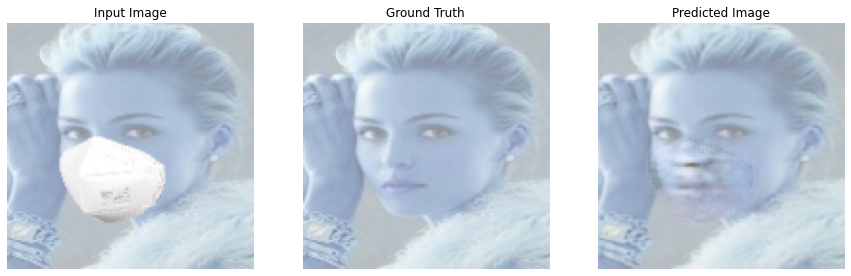

In [ ]:
for inp, tar in train_data.take(20):
  generate_images(generator, inp, tar)


Some of the images predicted without masks of the celebrities are really amazing and seems to be recognizable to us. But still, there are some images that did not show better results and has some remains of the mask pixels. But they are also not that bad, and can be recognized. Overall, the model worked very well and we see amazing results of the faces of celebrities predicted underneath the mask.

The GAN model seems to work best with front-facing people rather than side profiles. Images generated for people with side profiles had some noise and most have failed to generate a proper recreation of the nose area. Our GAN model, though only uses about a 1000 training samples and about 500 test samples from the whole dataset. There is labelled data in this dataset so finding other images of the same person was a difficult task and had to be done manually.

In this project, as our main task was to predict the face underneath the mask from the images with masks, we used **Generative Adverserial Network model (GAN model)** for predicting the same.

For that, firstly we divided the problem into two stages of **'Mask object detection'** and **'Image Generation of the Removed mask region'**.

In the first stage of our model, the model automatically produces binary segmentation for the mask region, while in the second stage, it removes the mask and synthesizes the affected region with fine details while retaining the global coherency of the face structure for what we used the GAN model.

The GAN model consisted of two main components viz. Generator and the Discriminator. The Generator's task was to produce the fake images but like real data to fool the Discriminator. And the task of the Discriminator was to predict whether the image is from actual data or it's fake (as in produced by generator). After building the Generator and Discriminator, we intialized loss function and optimizers for both the networks. In Generator loss, our main aim was to minimize the loss by fooling the Discriminator, while in Discriminator, we minimized the loss by predicting data's actual label, and find out that whether the image is from generator or not.


We can conclude that the model worked pretty well and showed us good results of the predicted images generated without masks from the celebrities faces with masks.

#### Conclusion

Since the dataset was not a pre-made dataset and we had to run another auxillary python code that generated masked images after considering the facial landmarks of the person. The masks that were generated on the images were randomized for each image.

Time held us back from trying more experiments with the AutoEncoder-DeMask and GAN model, since training so many different models was time consuming, but we are satisfied with how it turned out. This project started with a lot of reserach on all the individual concepts and how to use them together efficiently.

We initially faced problems with reading the data since it was taking up a lot of space when stored in numpy arrays. With about 26000 images in total using up that much memory was just not possible.

###References used for GAN model understanding:





1.  This website helped us understand how to develop a Pix2pix GAN model for Image-to-image translation. https://machinelearningmastery.com/how-to-develop-a-pix2pix-gan-for-image-to-image-translation/
2.  This part helped us to first basically understand the working of GAN model and how to implement it practically. https://github.com/eriklindernoren/Keras-GAN
3. This website helped us to learn the concept of GANs with Keras and TensorFlow. https://pyimagesearch.com/2020/11/16/gans-with-keras-and-tensorflow/
4. Zhu, Jun-Yan, Taesung Park, Phillip Isola, and Alexei A. Efros. "Unpaired Image-to-Image Translation
Using Cycle-Consistent Adversarial Networks." In 2017 IEEE International Conference on Computer Vision (ICCV), 2242–2251.
Venice: IEEE, 2017. https://ieeexplore.ieee.org/document/8237506
5. This source helped us to know more about Image-to-Image translation with Conditional Adverserial Networks:
Isola, Phillip, Jun-Yan Zhu, Tinghui Zhou, and Alexei A. Efros. "Image-to-Image Translation with
Conditional Adversarial Networks." In 2017 IEEE Conference on Computer Vision and Pattern Recognition (CVPR),
 5967–76. Honolulu, HI: IEEE, 2017. https://arxiv.org/abs/1611.07004





